## Eigenfaces

### Part 1
1. Load all the 25 images in the "/Eigenfaces/Train"
2. Display all the original faces in a 5X5 grid. Resize the images to 100X100 pixels for display only.
3. Find the mean face image. Perform PCA on the training faces.
4. Display the mean face. Resize the mean face to 100X100 pixels for display only
5. Diplay all the eigenfaces in a 5X5 grid.

In [1]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np

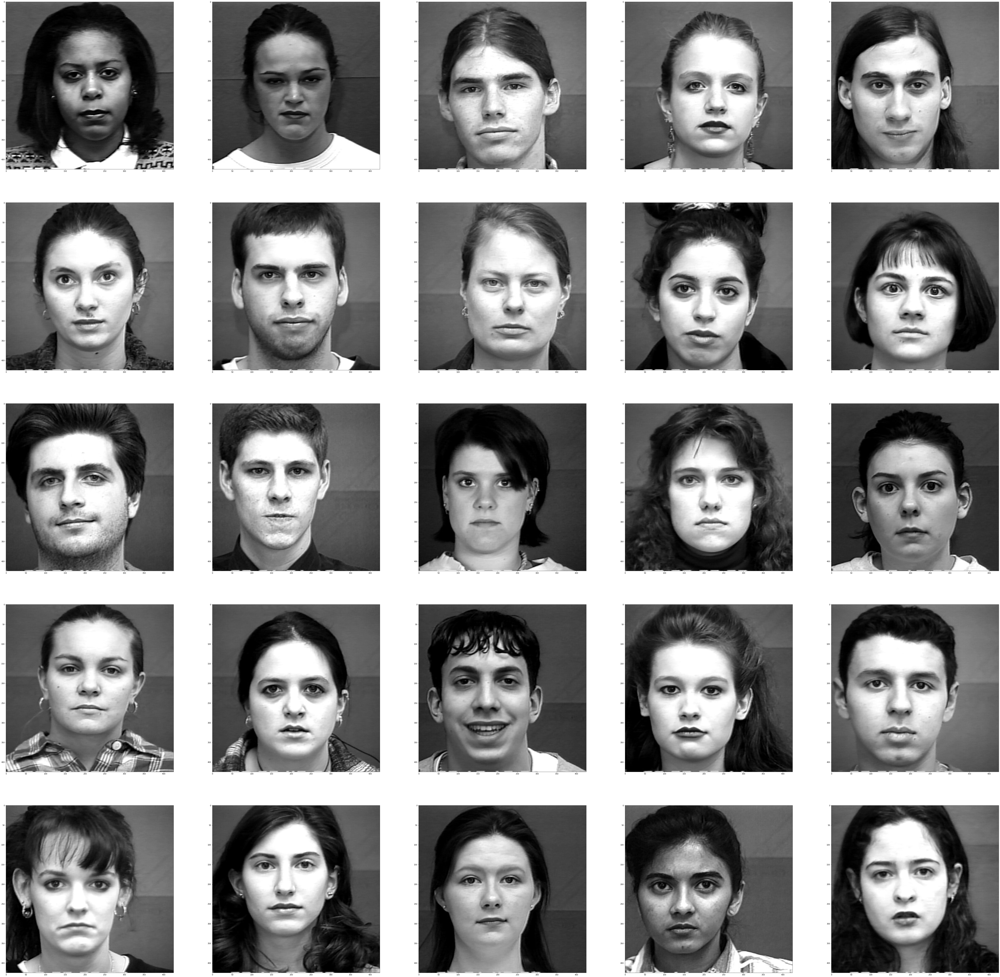

In [2]:
# Define the folder path containing all training images
train_path = "./Eigenfaces/Train/"

# Load all 25 train images
images_arr = []
images_names = os.listdir(train_path)

for i in images_names:
    image = cv2.imread(train_path + i, cv2.COLOR_BGR2GRAY)
    images_arr.append(image)
images_arr = np.array(images_arr)

# display all the train faces in 5x5 grid
counter = 1
plt.figure(figsize=(100,100))
for i in range(5):
    for j in range(5):
        image = images_arr[i * 5 + j]
        plt.subplot(5,5,(i * 5 + j)+1)
        plt.imshow(image,cmap='gray')
plt.show()

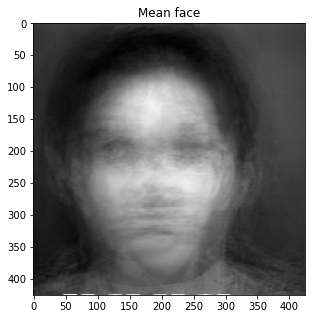

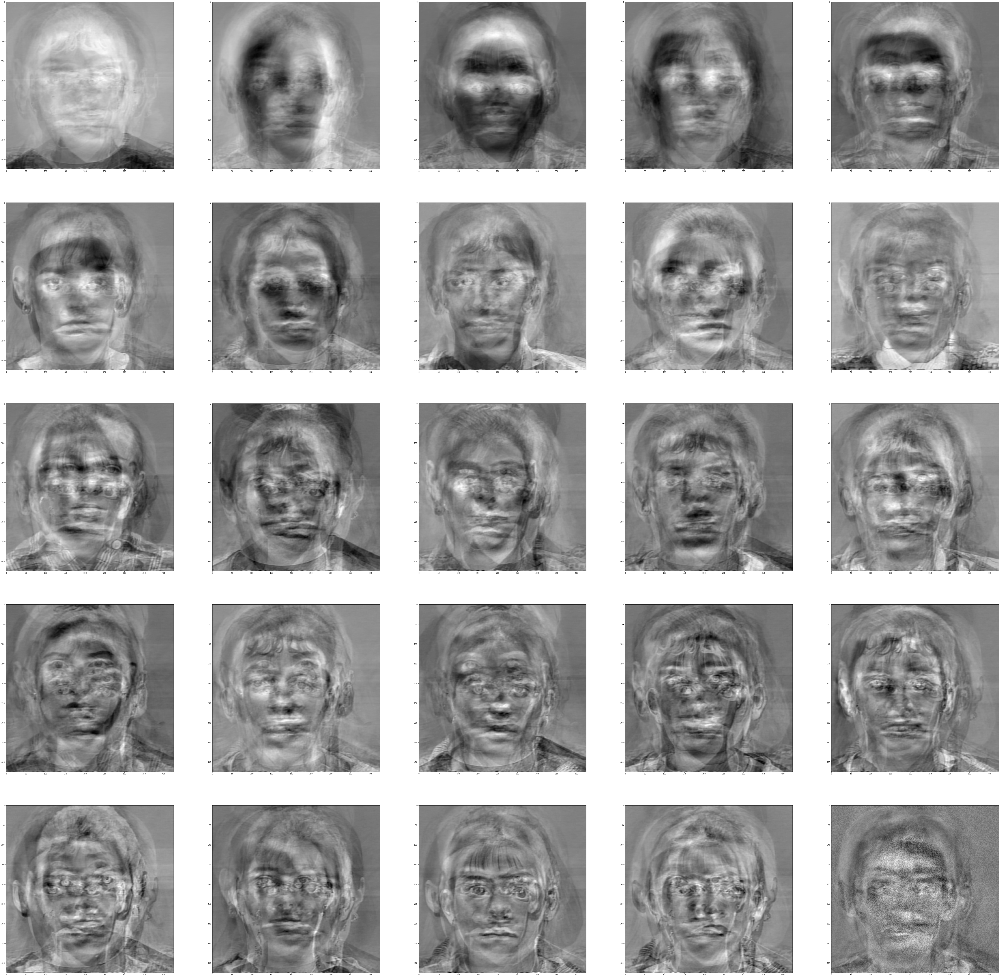

In [3]:
# Function to compute the eigen faces or basically PCA and mean face
def compute_PCA(images_arr, ncomponents = 2):
    matrix = np.array([image.flatten() for image in images_arr])
    mean, eigenvectors = cv2.PCACompute(matrix, mean=None,maxComponents=ncomponents)
    mean_reshape = np.reshape(mean, images_arr[0].shape)
    mean_reshape = mean_reshape / 255.0
    plt.figure(figsize=(5,5))
    plt.imshow(mean_reshape, interpolation="nearest", cmap="gray")
    plt.title("Mean face")
    plt.show()
    return matrix, mean, eigenvectors

ncomp = 25 # since there are 25 images
faces, mean, evec = compute_PCA(images_arr,ncomp)

# display the computed eigen faces in 5x5 grid
plt.figure(figsize=(100,100))
for i in range(ncomp):
    eigenface1 = evec[i,:]
    eigenface1 = np.reshape(eigenface1, images_arr[0].shape)
    eigenface1 = eigenface1 - eigenface1.min()
    eigenface1 = eigenface1/eigenface1.max()
    plt.subplot(5,5,i+1)
    plt.imshow(eigenface1,cmap='gray')
plt.show()

### Part 2

1. Select k = 2 eigenfaces (eigenvectors that correspond to the largest eigenvalues).
2. Reconstruct the training faces and display the reconstructed faces in a 5X5 grid.
3. Repeat the process for k = 5 and k = 15. For each k, reconstruct the training faces and display the reconstructed image in a 5X5 grid.

Plotting each train face after projection and back propagation for k = 2.


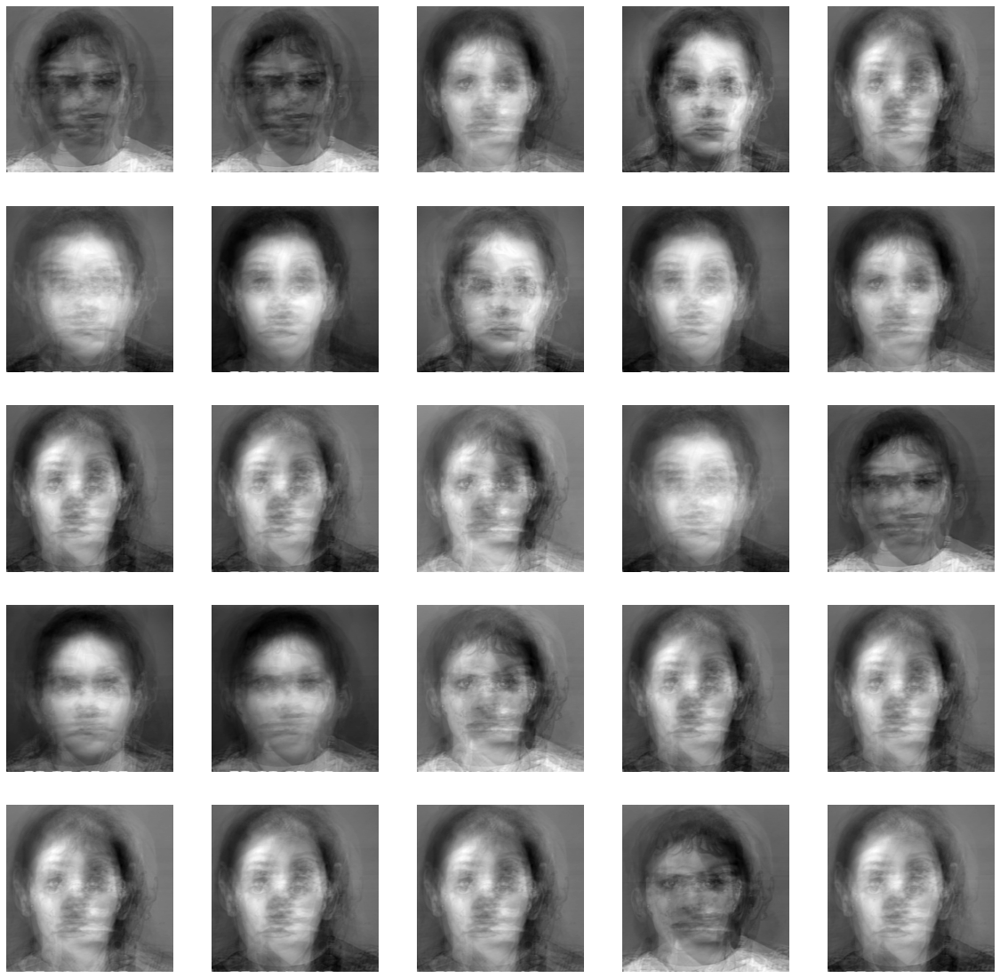

Plotting each train face after projection and back propagation for k = 5.


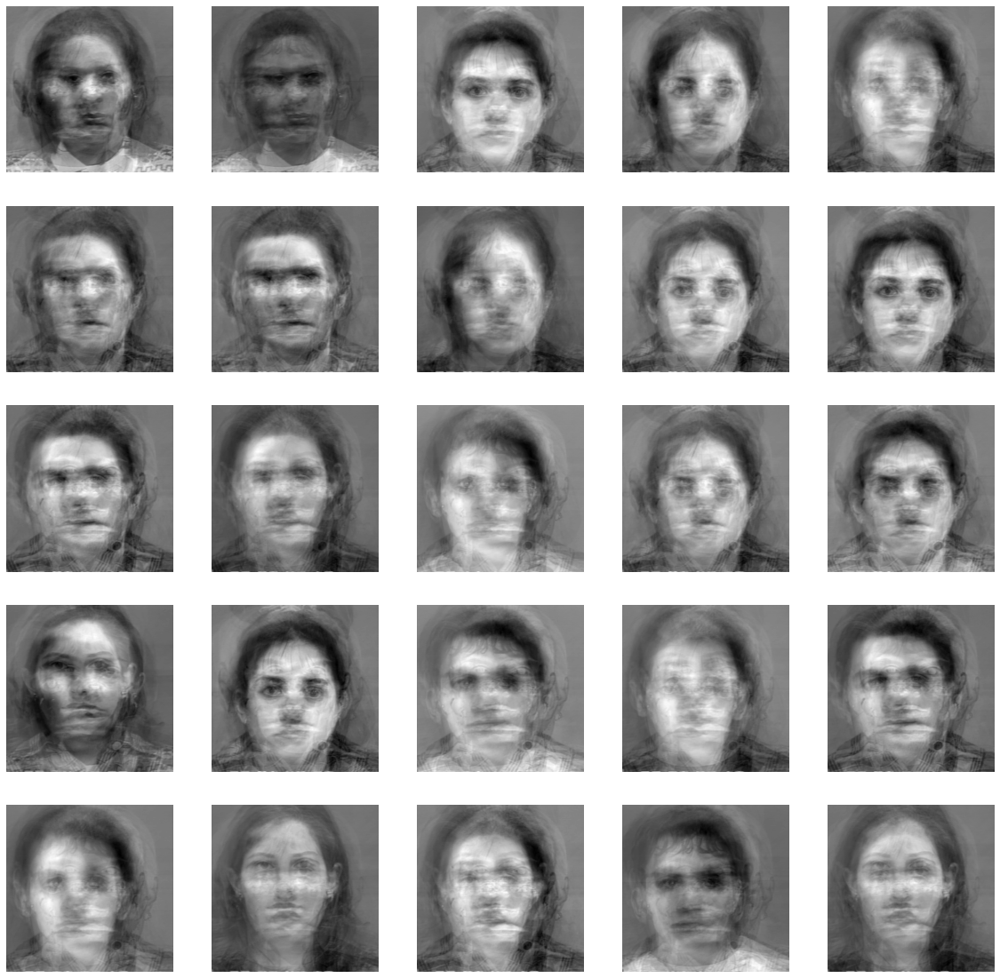

Plotting each train face after projection and back propagation for k = 15.


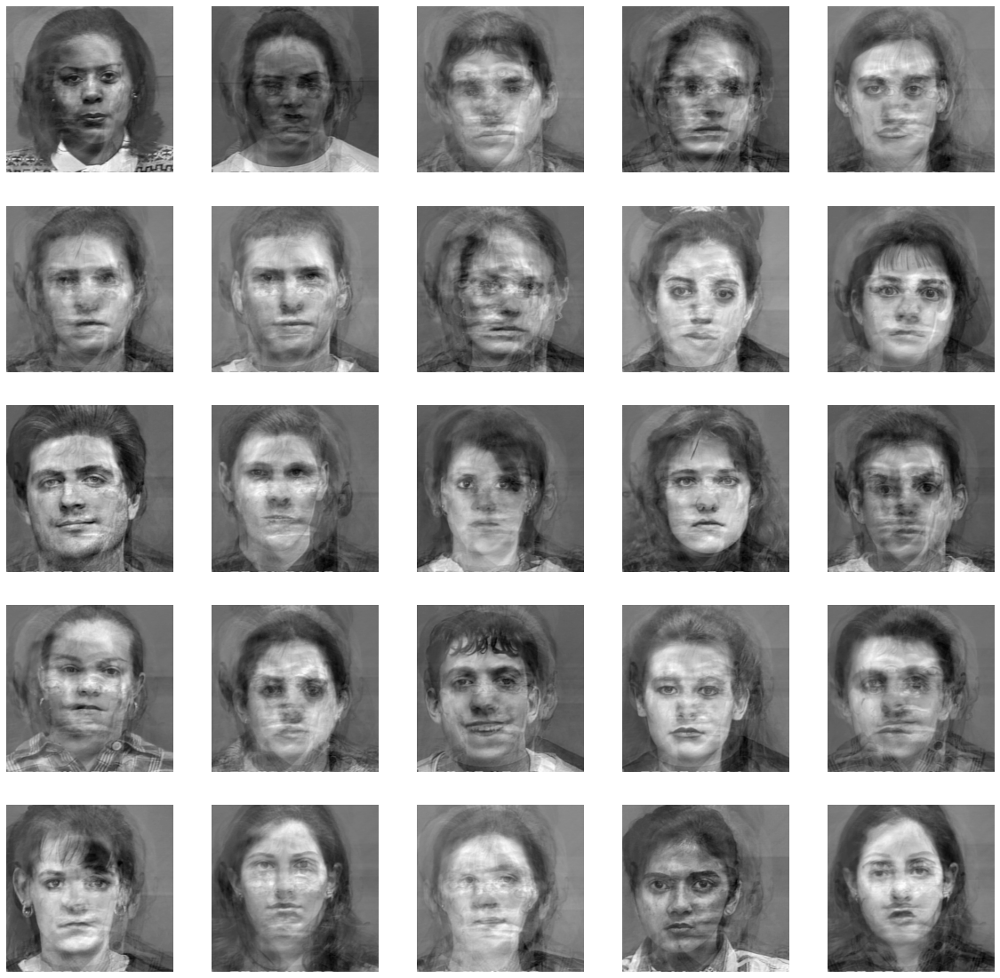

In [4]:
# Reference for below 3 functions are the MATLAB codes present in lecture slides
def normalize_face(image_window, mean_face = None):
    result = image_window.flatten()
    result = result - result.mean()
    result = result / result.std()
    return result

def eigenface_projection(image_window, mean_face, eigenvectors):
    normalized = normalize_face(image_window, mean_face)
    centered = normalized - mean_face
    # result = eigenvectors * centered
    result = np.dot(eigenvectors, centered[0])
    return result

def pca_backprojection(projection, average, eigenvectors):
    centered_result = np.dot(projection, eigenvectors)
    result = centered_result + average
    return result

mean_copy = mean.copy()
mean_copy = mean_copy - mean_copy.min()
mean_copy = mean_copy/mean_copy.max()
for k in [2,5,15]:
    print("Plotting each train face after projection and back propagation for k = " + str(k) + ".")
    plt.figure(figsize=(20,20))
    for img_no in range(25):
        f1 = faces[img_no,:]
        projection = eigenface_projection(f1, mean_copy, evec[:k,:])
        reconstruction = pca_backprojection(projection, mean_copy, evec[:k,:])
        plt.subplot(5,5,img_no+1)
        plt.axis("off")
        plt.imshow(np.reshape(reconstruction,images_arr[0].shape),cmap='gray')
    plt.show()

### Part 3
1. Load all the test images from "/Eigenfaces/Test"
2. Project each image on the k = 2 eigenvectors and find if it's a face. If it's a face, find it's closest training image. Use euclidean distance to calculate distance.
3. Display all the results in an M X 2 table, where M is total no of test images. Each row of the table displays two images. The image on the left is the test image. The image on the right is it's closest image in the eigenfaces space. If an image is classified as a non-face, then the second column in the table should be blank.
4. Repeat the process and display the results for k = 5, k = 15.

Plotting all the 32 test images...


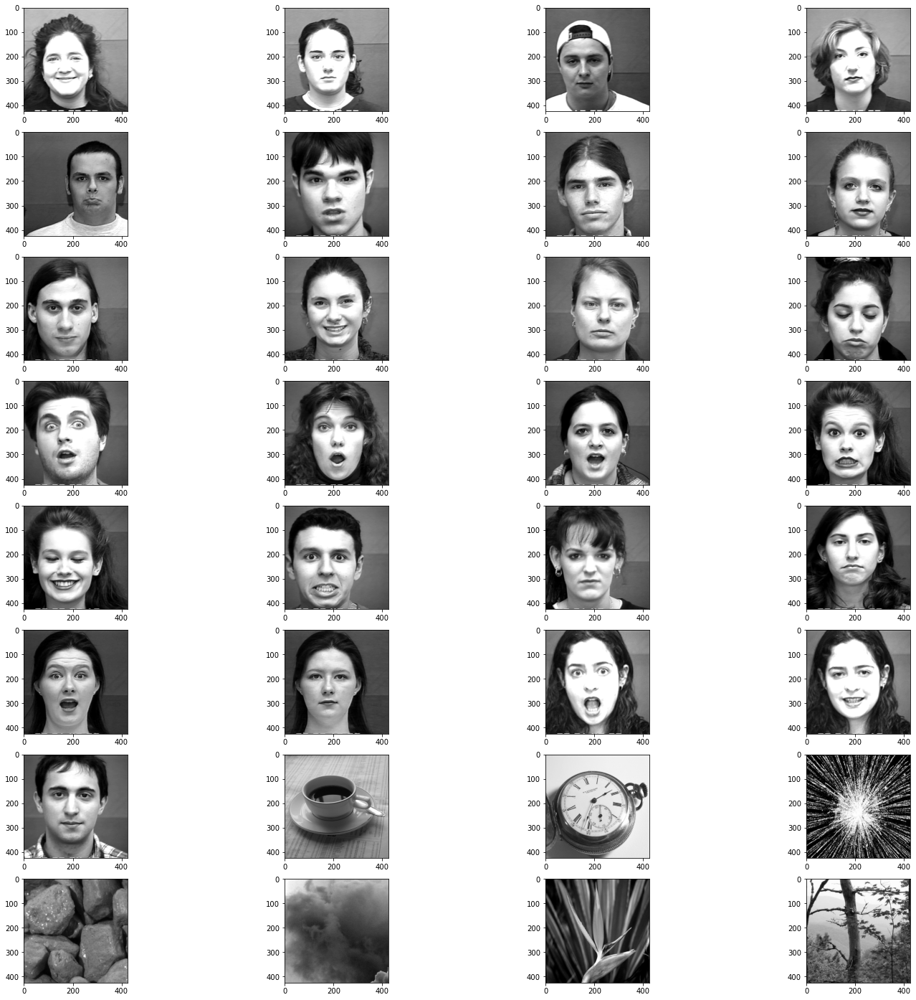

In [5]:
# Define the folder path containing all test images
test_path = "./Eigenfaces/Test/"

# collect all the test images
images_arr_test = []
images_names = os.listdir(test_path)

for i in images_names:
    if i.endswith(".jpg"):
        image = cv2.imread(test_path + i)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        images_arr_test.append(image)
images_arr_test = np.array(images_arr_test)

# plot all the 32 images
print("Plotting all the 32 test images...")
plt.figure(figsize=(25,25))
for i in range(4):
    for j in range(8):
        image = images_arr_test[i * 8 + j]
        plt.subplot(8,4,(i * 8 + j)+1)
        plt.imshow(image,cmap='gray')
plt.show()

I have done two different implementations for the remaining part of task 3. I have found the PCA score for each face and applied thresholding to classify if the image is a face or not. This part remains same in both the implementations. The difference is in the method to find the closest match.

In the implementation below, in order to find the closest matching face from train images, I have calculated the L2 (euclidean) distance between the test image and each train image. The one with minimum distance is the closest match.

k = 2 and threshold = 168000.


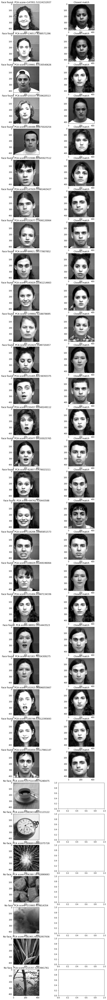

k = 5 and threshold = 162000.


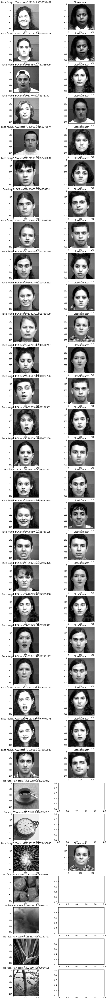

k = 15 and threshold = 144000.


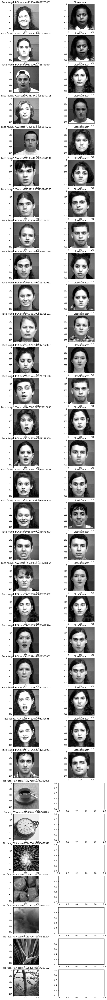

In [6]:
# Reference for the below two functions is the MATLAB code present in the lecture slides
def pca_score(window, mean_face, eigenvectors, eigenface_number):
    window = np.reshape(window, mean_face.shape)
    window = window - window.mean()
    window = window / window.std()
    top_eigenvectors = eigenvectors[:eigenface_number]
    projection = eigenface_projection(window, mean_face, top_eigenvectors)
    reconstruction = pca_backprojection(projection, mean_face, top_eigenvectors)
    diff = reconstruction - window
    result = np.dot(diff[0], diff[0])
    result = result.sum()
    return result, reconstruction

def normalize_face(image_window, mean_face = None):
    result = image_window.flatten()
    result = result - result.mean()
    result = result / result.std()
    return result

# Function to return the closest match from train dataset
# using euclidean distance i.e. L2 norm
def euclidean_dist(train_dataset, comp_face):
    dist = []
    comp_face = normalize_face(comp_face)
    for i in train_dataset:
        norm = normalize_face(i)
        diff = comp_face - norm
        result = np.dot(diff[0], diff[0])
        result = result.sum()
        dist.append(result)
    return train_dataset[np.argmin(dist)]

mean_copy = mean.copy()
mean_copy = mean_copy - mean_copy.min()
mean_copy = mean_copy/mean_copy.max()

thres_dict = {2: 168000, 5: 162000, 15: 144000} # these threshold values was found by trial and error
k = 15

# check if the test image is a face or not using pca_score function and thresholding
# and then find the closest match
for k in [2,5,15]:
    thres = thres_dict[k]
    print("k = " + str(k) + " and threshold = " + str(thres) + ".")
    fig, axes = plt.subplots(nrows=32, ncols=2, figsize=(10,100))
    for img_no in range(32):
        f1 = images_arr_test[img_no]
        x, reconstruction = pca_score(f1, mean_copy, evec, k)
        
        if x >= thres:
            axes[img_no, 0].imshow(f1, cmap='gray')
            axes[img_no, 0].set_title("No face. PCA score=" + str(x))
        else:
            axes[img_no, 0].imshow(f1, cmap='gray')
            axes[img_no, 0].set_title("Face found. PCA score=" + str(x))
            match = euclidean_dist(images_arr, np.reshape(f1, images_arr[0].shape))
            axes[img_no, 1].imshow(match, cmap='gray')
            axes[img_no, 1].set_title("Closest match")
            counter += 1
    plt.show()

In this second implementation, for finding the closest match from train dataset, I have found the L2 distance between each train face and the reconstructed version of the test face. This is because, I noticed that when the test image is projected to eigen faces of train dataset, if the face is similar then the reconstructed face is very much similar to the closest match in the train dataset. Below is an example of the same.

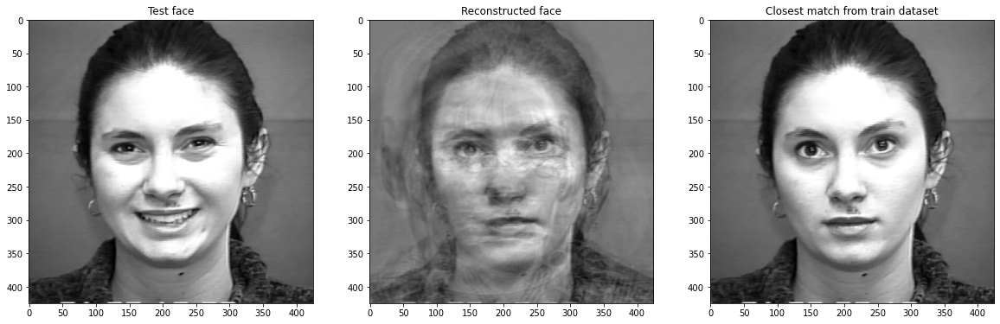

In [7]:
def pca_score(window, mean_face, eigenvectors, eigenface_number):
    window = np.reshape(window, mean_face.shape)
    window = window - window.mean()
    window = window / window.std()
    top_eigenvectors = eigenvectors[:eigenface_number]
    projection = eigenface_projection(window, mean_face, top_eigenvectors)
    reconstruction = pca_backprojection(projection, mean_face, top_eigenvectors)
    diff = reconstruction - window
    result = np.dot(diff[0], diff[0])
    result = result.sum()
    return result, reconstruction

k = 22
thres = 144000
img_no = 9
f1 = images_arr_test[img_no]
x, reconstruction = pca_score(f1, mean_copy, evec, k)
plt.figure(figsize=(20,20))
plt.subplot(1,3,1)
plt.title("Test face")
plt.imshow(f1,cmap='gray')
plt.subplot(1,3,2)
plt.title("Reconstructed face")
plt.imshow(np.reshape(reconstruction,f1.shape),cmap='gray')
plt.subplot(1,3,3)
plt.title("Closest match from train dataset")
plt.imshow(images_arr[5],cmap='gray')
plt.show()

As seen in the above scenario, we can see that the reconstructed face is more similar to the closest match in the train dataset. So below is an implementation similar to the implementation 1 but the only difference is that, in order to find the closest match, I have calculated the L2 distance between each train dataset image and the reconstructed image.

k = 2 and threshold = 168000.


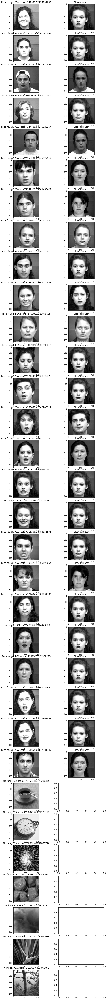

k = 5 and threshold = 162000.


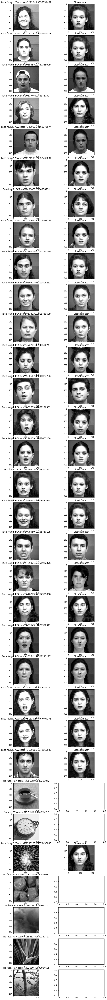

k = 15 and threshold = 144000.


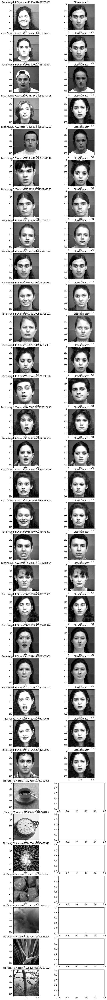

In [8]:
def pca_score(window, mean_face, eigenvectors, eigenface_number):
    window = np.reshape(window, mean_face.shape)
    window = window - window.mean()
    window = window / window.std()
    top_eigenvectors = eigenvectors[:eigenface_number]
    projection = eigenface_projection(window, mean_face, top_eigenvectors)
    reconstruction = pca_backprojection(projection, mean_face, top_eigenvectors)
    diff = reconstruction - window
    result = np.dot(diff[0], diff[0])
    result = result.sum()
    return result, reconstruction

def normalize_face(image_window, mean_face = None):
    result = image_window.flatten()
    result = result - result.mean()
    result = result / result.std()
    return result

def euclidean_dist(train_dataset, comp_face):
    dist = []
    for i in train_dataset:
        norm = normalize_face(i)
        # reconstructed_face = normalize_face(reconstructed_face)
        diff = comp_face - norm
        result = np.dot(diff[0], diff[0])
        result = result.sum()
        dist.append(result)
    return train_dataset[np.argmin(dist)]

mean_copy = mean.copy()
mean_copy = mean_copy - mean_copy.min()
mean_copy = mean_copy/mean_copy.max()

thres_dict = {2: 168000, 5: 162000, 15: 144000} # these threshold values was found by trial and error
k = 15

for k in [2,5,15]:
    thres = thres_dict[k]
    print("k = " + str(k) + " and threshold = " + str(thres) + ".")
    fig, axes = plt.subplots(nrows=32, ncols=2, figsize=(10,100))
    for img_no in range(32):
        f1 = images_arr_test[img_no]
        x, reconstruction = pca_score(f1, mean_copy, evec, k)
        
        if x >= thres:
            axes[img_no, 0].imshow(f1, cmap='gray')
            axes[img_no, 0].set_title("No face. PCA score=" + str(x))
        else:
            axes[img_no, 0].imshow(f1, cmap='gray')
            axes[img_no, 0].set_title("Face found. PCA score=" + str(x))
            match = euclidean_dist(images_arr, reconstruction)
            axes[img_no, 1].imshow(match, cmap='gray')
            axes[img_no, 1].set_title("Closest match")
            counter += 1
    plt.show()

Assignment Courtesy: Prof. Farhad Kamangar, CSE@UTA